In [ ]:
import zipfile
zip_file_path = '/content/archive.zip'
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
  zip_ref.extractall('/content/horse2zebra-dataset')
# extracting the dataset horse2zebra

In [ ]:
# importing necessary libraries
import os
import keras
import numpy as np
from glob import glob
from tqdm import tqdm
import tensorflow as tf
from random import random
import matplotlib.pyplot as plt

In [ ]:
# defining paths for horse and zebra datasets
root_horse_path = '/content/horse2zebra-dataset/trainA'
root_zebra_path = '/content/horse2zebra-dataset/trainB'
horse_paths = sorted(glob(root_horse_path + '/*.jpg'))[:1000]
zebra_paths = sorted(glob(root_zebra_path + '/*.jpg'))[:1000]

In [ ]:
import tensorflow as tf
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array

SIZE = 256
horse_images, zebra_images = [], []
# resizing the images and storing them in lists
# each image is resized to 256X256 shape
for horse_path, zebra_path in tqdm(zip(horse_paths, zebra_paths), desc='Loading'):
    horse_image = img_to_array(load_img(horse_path))
    horse_image = tf.image.resize(tf.cast(horse_image, tf.float32) / 255., (SIZE, SIZE)).numpy()
    horse_images.append(horse_image)
    zebra_image = img_to_array(load_img(zebra_path))
    zebra_image = tf.image.resize(tf.cast(zebra_image, tf.float32) / 255., (SIZE, SIZE)).numpy()
    zebra_images.append(zebra_image)
horse_images = np.stack(horse_images)
zebra_images = np.stack(zebra_images)
# images are stacked in the appropriate arrays

Loading: 1000it [00:08, 116.00it/s]


In [ ]:
dataset = [horse_images, zebra_images]
# final datasets contains lists of horse and zebra images

In [ ]:
def update(index, imags, max_size=50):
    selec = []
    for image in imags:
        if len(index) < max_size:
            index.append(image)
            selec.append(image)
        elif random() < 0.5:
            selec.append(image)
        else:
            ix = np.random.randint(0,len(index))
            selec.append(index[ix])
            index[ix] = image
    sel = np.asarray(selec)
    return sel
# the above function is used append images according
# to the batch size, if length of batch size is less
# than the maximum size we have defined he appends that many
# images else it randomly selects images and returns them

In [ ]:
from keras.layers import Activation
from keras.layers import concatenate
from keras.layers import ZeroPadding2D
from keras.layers import Conv2DTranspose
from tensorflow_addons.layers import InstanceNormalization
from keras.layers import ReLU
from keras.layers import Input
from keras.layers import LeakyReLU
from keras.layers import Conv2D
from keras.layers import Dropout
# importing necessary libraries
# including conv2D layer, dropout and leakyrelu layers

/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


In [ ]:
# function for residual connection
# residual connection is concatenation of x and convolution
# on x followed by normalization and relu
def Residual(filters, layer):
    x = Conv2D(filters, kernel_size=3, strides=1, padding='same', kernel_initializer='he_normal')(layer)
    x = InstanceNormalization(axis=-1)(x)
    x = ReLU()(x)
    x = Conv2D(filters, kernel_size=3, strides=1, padding='same', kernel_initializer='he_normal')(x)
    x = InstanceNormalization(axis=-1)(x)
    x = concatenate([x, layer])
    return x


In [ ]:
# downsample function is used to decrease the size of the layers
# using convolution and leakyrelu
# strides is 2 to reduce size by half at each call
def downsample(filters, layer, size=3, strides=2, activation=None, index=None, norm=True):
    x = Conv2D(filters, kernel_size=size, strides=strides, padding ='same', kernel_initializer='he_normal', use_bias=False)(layer)
    x = InstanceNormalization(axis=-1)(x)
    x = LeakyReLU()(x)
    return x

In [ ]:
# upsample function is  used to increase the size of the layers
# it is implemented by using transpose convolution followed by normalization
# and relu
def upsample(filters, layer, size=3, strides=2):
    x = Conv2DTranspose(filters, kernel_size=size, strides=strides, padding='same', kernel_initializer='he_normal')(layer)
    x = InstanceNormalization(axis=-1)(x)
    x = ReLU()(x)
    return x

In [ ]:
from keras.models import Model
from keras.initializers import RandomNormal
from tensorflow.keras.optimizers import Adam
# importing optimizer Adam and random initialization
# for generating the images

In [ ]:
# generator class which consists of downsampling, followed by
# residual connections and upsampling
def Generator(n_resnet=9):
    inp_image =Input(shape=(SIZE, SIZE, 3))
    x = downsample(64, inp_image, size=7, strides=1)
    x = downsample(128, x)
    x = downsample(256, x)
    for i in range(n_resnet):
        x = Residual(256, x)
    x = upsample(128, x)
    x = upsample(64, x)
    x = downsample(3, x, size=7, strides=1, activation='tanh')
    model = Model(inputs=inp_image, outputs=x)
    return model

In [ ]:
# discriminator class which consists of downsampling followed
# by convolution
def Discriminator():
    init = RandomNormal(stddev=0.02)
    src_img = Input(shape=(SIZE, SIZE, 3))
    x = downsample(64, src_img, size=4, strides=2, norm=False)
    x = downsample(128, x, size = 4)
    x = downsample(256, x, size = 4)
    x = downsample(512, x, size = 4)
    x = downsample(512, x, size = 4)
    output = Conv2D(1, kernel_size=4, padding='same', kernel_initializer= init, use_bias=False)(x)
    model = Model(inputs=src_img, outputs= output)
    model.compile(loss='mse', optimizer=Adam(learning_rate=2e-3))
    return model

In [ ]:
# cycleGan class which defines the model used
# which are generator and discriminator used in a
# sequence to generate good models
# the different loss functions used are mse, mae, mae, mae

def Cycle_GAN(g_model1,g_model2, d_model ):
    g_model1.trainable = True
    d_model.trainable = False
    g_model2.trainable = False
    input_gen = Input(shape=(SIZE, SIZE, 3))
    gen_1_out = g_model1(input_gen)
    dis_out = d_model(gen_1_out)
    input_id = Input(shape=(SIZE, SIZE, 3))
    output_id = g_model1(input_id)
    output_f = g_model2(gen_1_out)
    gen_2_out = g_model2(input_id)
    output_b = g_model1(gen_2_out)
    model = Model(inputs=[input_gen, input_id],
                 outputs=[dis_out, output_id,output_f, output_b ])
    model.compile(loss=['mse', 'mae', 'mae', 'mae'], loss_weights=[1, 5, 10, 10], optimizer=Adam(learning_rate=2e-4))
    return model

In [ ]:
# function to plot the original, generated images
# given model
def show(g_AB, g_BA, n_images=1):
    for i in range(n_images):
        id = np.random.randint(len(horse_images))
        horse, zebra = horse_images[id], zebra_images[id]
        horse_pred, zebra_pred = g_BA.predict(tf.expand_dims(zebra, axis=0))[0], g_AB.predict(tf.expand_dims(horse, axis=0))[0]

        plt.figure(figsize=(10, 8))

        plt.subplot(1, 4, 1)
        title='Original Horse'
        plt.imshow(horse)
        plt.title(title)
        plt.axis('off')

        plt.subplot(1, 4, 2)
        title='Generated Zebra'
        plt.imshow(zebra_pred)
        plt.title(title)
        plt.axis('off')

        plt.subplot(1, 4, 3)
        title='Original Zebra'
        plt.imshow(zebra)
        plt.title(title)
        plt.axis('off')

        plt.subplot(1, 4, 4)
        title='Generated Horse'
        plt.imshow(horse_pred)
        plt.title(title)
        plt.axis('off')
        plt.show()

In [ ]:
# training function when two models, generators are given
def train(model_A, model_B, gen_AB, gen_BA, c_AB, c_BA, epochs=10):
    n_epochs, n_batch = epochs, 1
    trainA, trainB = dataset
    poolA, poolB = list(), list()

    batch_per_epoch = int(len(trainA)/n_batch)
    n_steps = batch_per_epoch
    k=0
    for j in tqdm(range(1, epochs+1)):
        for i in range(n_steps):
            # generating random data
            ix = np.random.randint(0, trainA.shape[0], n_batch)
            X_realA = trainA[ix]
            y_realA = np.ones(shape=(n_batch, 8, 8, 1))
            ix = np.random.randint(0, trainB.shape[0], n_batch)
            X_realB = trainB[ix]
            y_realB = np.ones(shape=(n_batch, 8, 8, 1))
            # generating fake data
            X_fakeA = gen_BA.predict(X_realB)
            y_fakeA = np.zeros(shape=(len(X_realB), 8, 8, 1))
            X_fakeB = gen_AB.predict(X_realA)
            y_fakeB = np.zeros(shape=(len(X_realA), 8, 8, 1))
            X_fakeA = update(poolA, X_fakeA)
            X_fakeB = update(poolB, X_fakeB)
            # training the model on batch
            gen_loss2 = c_BA.train_on_batch([X_realB, X_realA], [y_realB, X_realA, X_realB, X_realA])[0]
            dA_loss_1 = model_A.train_on_batch(X_realA, y_realA)
            dA_loss_2 = model_A.train_on_batch(X_fakeA, y_fakeA)
            gen_loss1= c_AB.train_on_batch([X_realA, X_realB], [y_realA, X_realB, X_realA, X_realB])[0]
            dB_loss_1 = model_B.train_on_batch(X_realB, y_realB)
            dB_loss_2 = model_B.train_on_batch(X_fakeB, y_fakeB)
            k+=1
            # displaying the images
            show(gen_AB, gen_BA, n_images=1)
            # saving the models
            gen_AB.save('/content/GeneratorHtoZ.h5')
            gen_BA.save('/content/GeneratorZtoH.h5')

In [ ]:
g_AB = Generator()
g_BA = Generator()
d_A = Discriminator()
d_B = Discriminator()
# defining the generators and discriminators
# for both conversion of horse to zebra and zebra to horse
c_AB = Cycle_GAN(g_AB, g_BA, d_B)
c_BA = Cycle_GAN(g_BA, g_AB, d_A)
# defining two cycle gan classes for each

  0%|          | 0/1 [00:00<?, ?it/s]

1/1 [==============================] - 0s 26ms/step


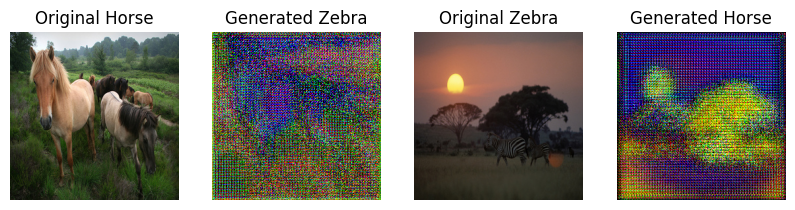

1/1 [==============================] - 0s 40ms/step


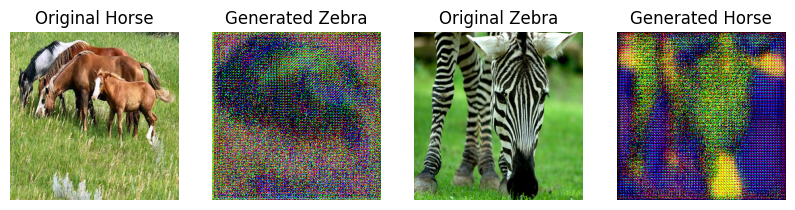

1/1 [==============================] - 0s 25ms/step


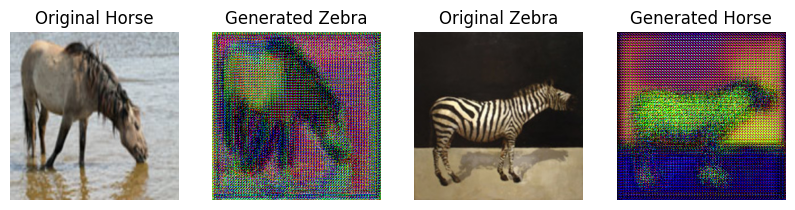

1/1 [==============================] - 0s 22ms/step


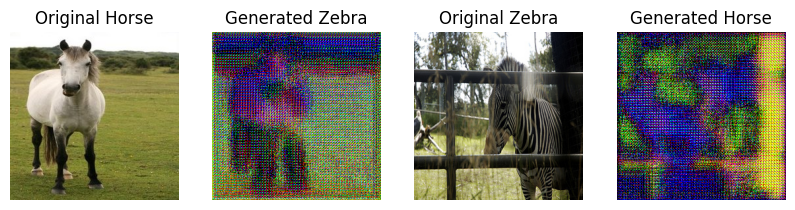

1/1 [==============================] - 0s 27ms/step


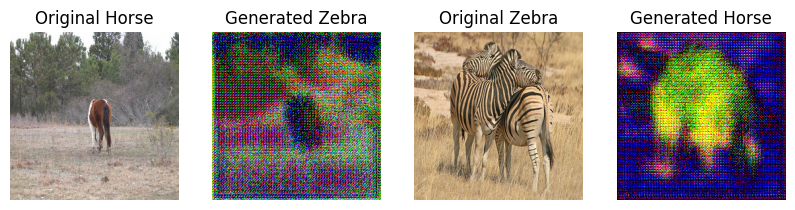

1/1 [==============================] - 0s 23ms/step


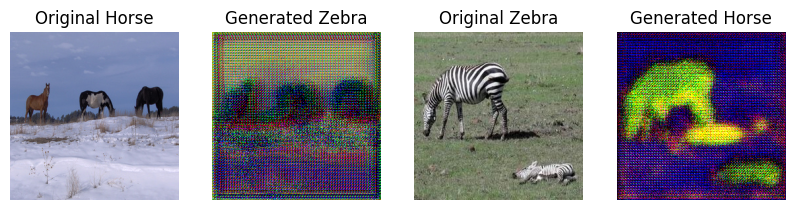

1/1 [==============================] - 0s 32ms/step


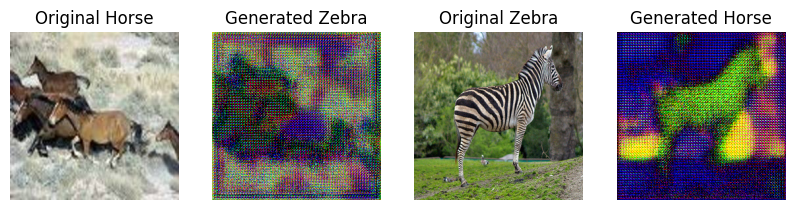

1/1 [==============================] - 0s 23ms/step


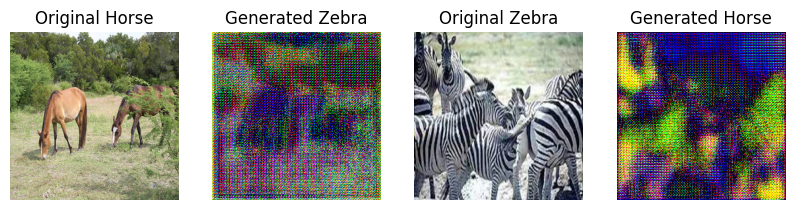

1/1 [==============================] - 0s 23ms/step


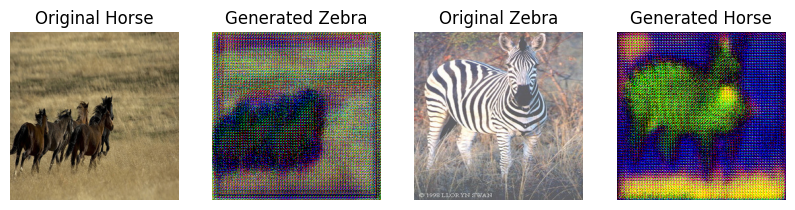

1/1 [==============================] - 0s 36ms/step


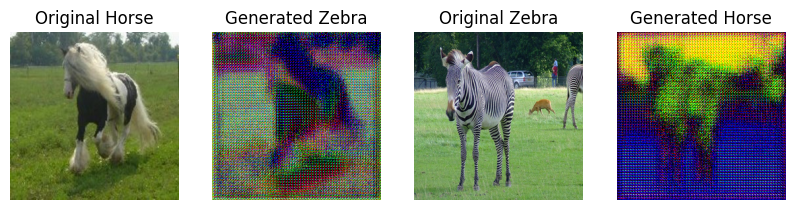

1/1 [==============================] - 0s 29ms/step


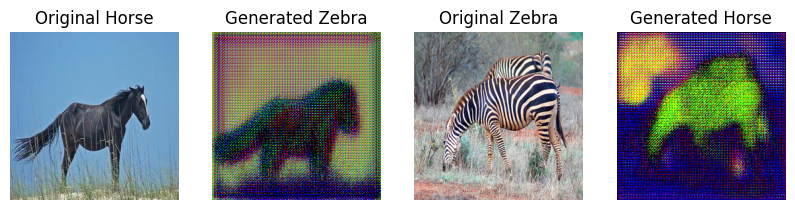

1/1 [==============================] - 0s 27ms/step


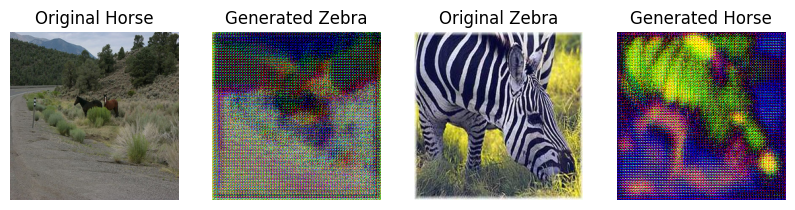

1/1 [==============================] - 0s 41ms/step


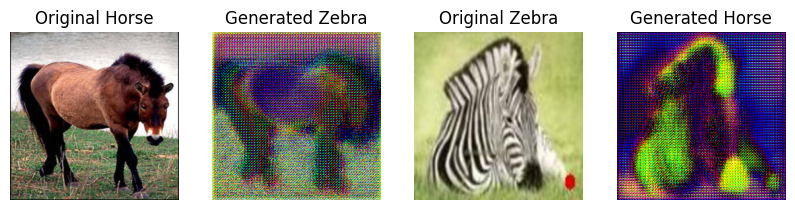

1/1 [==============================] - 0s 33ms/step


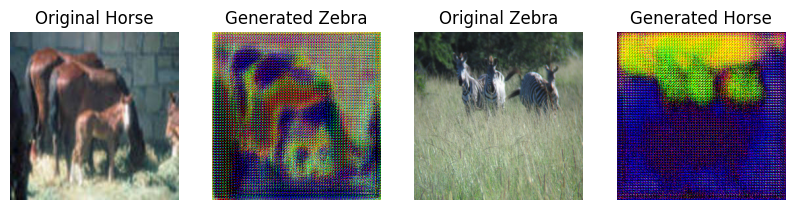

1/1 [==============================] - 0s 36ms/step


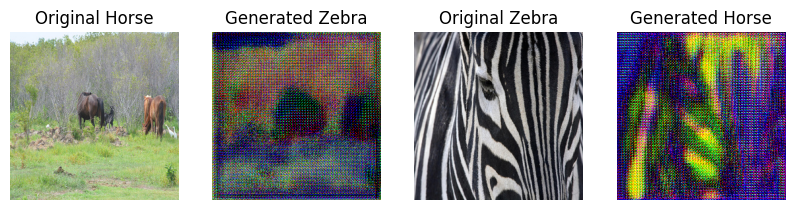

1/1 [==============================] - 0s 48ms/step


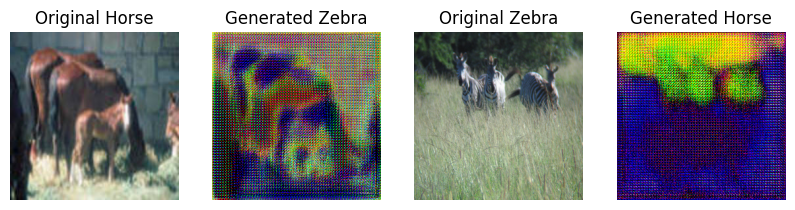

1/1 [==============================] - 0s 38ms/step


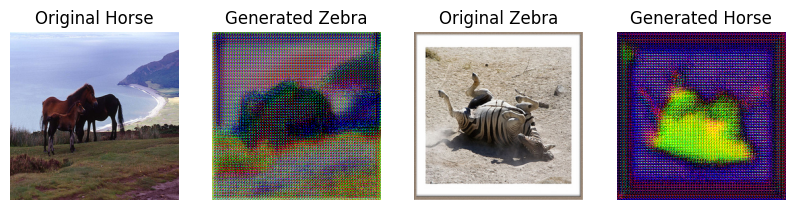

1/1 [==============================] - 0s 36ms/step


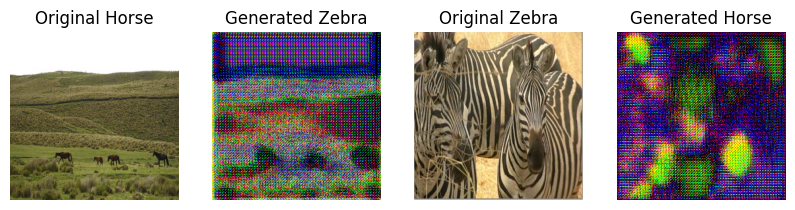

1/1 [==============================] - 0s 35ms/step


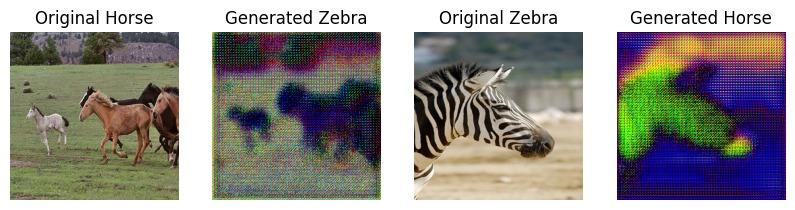

1/1 [==============================] - 0s 70ms/step


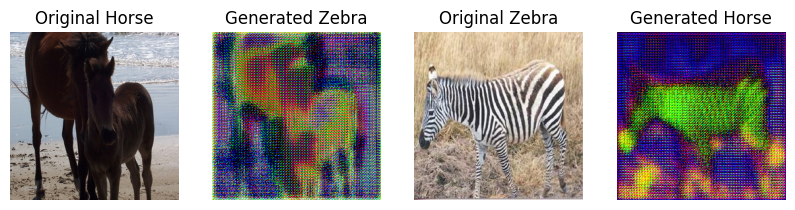

1/1 [==============================] - 0s 35ms/step


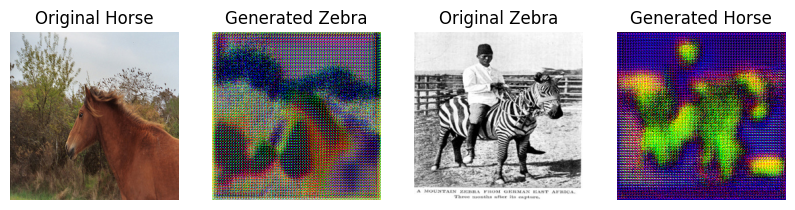

1/1 [==============================] - 0s 37ms/step


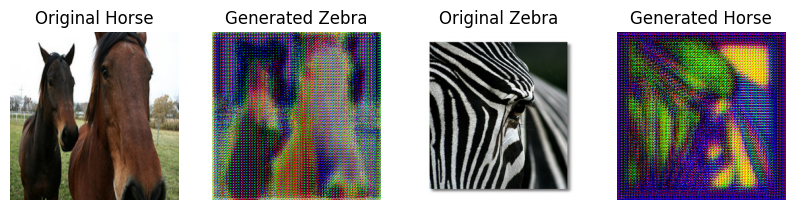

1/1 [==============================] - 0s 33ms/step


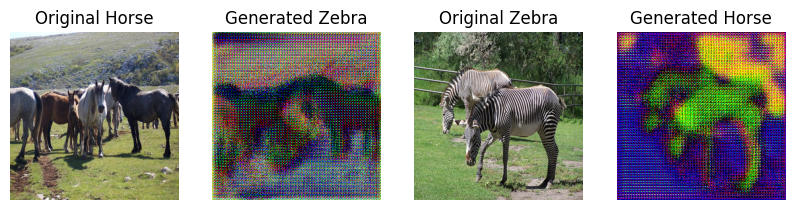

1/1 [==============================] - 0s 32ms/step


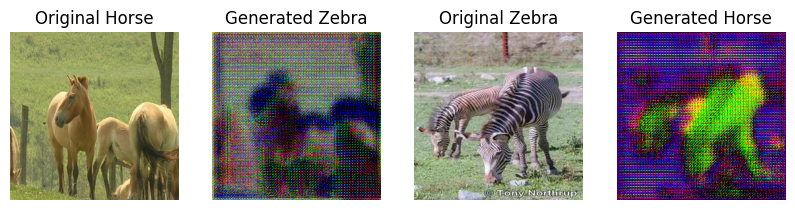

1/1 [==============================] - 0s 32ms/step


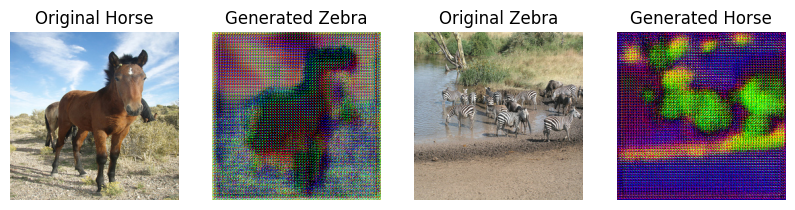

1/1 [==============================] - 0s 31ms/step


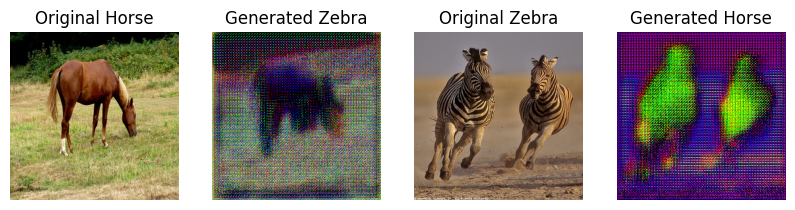

1/1 [==============================] - 0s 30ms/step


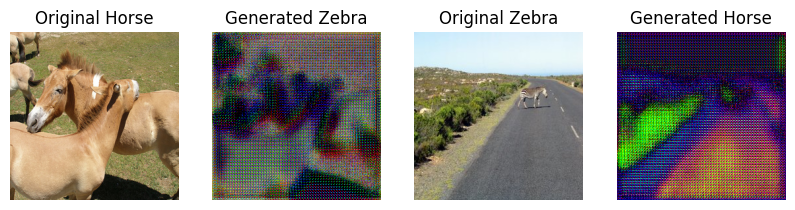

1/1 [==============================] - 0s 35ms/step


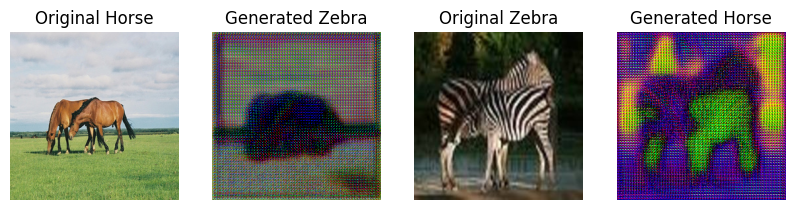

1/1 [==============================] - 0s 38ms/step


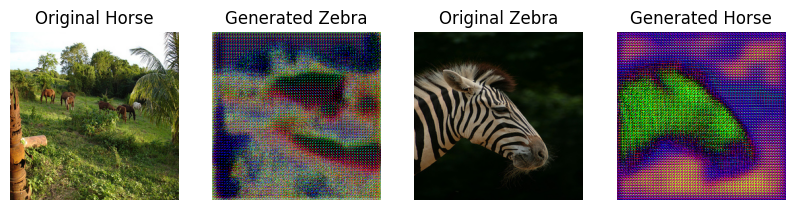

1/1 [==============================] - 0s 35ms/step


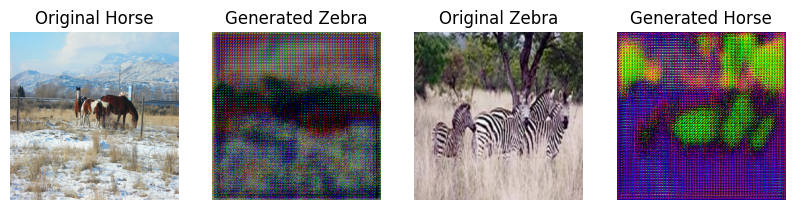

1/1 [==============================] - 0s 32ms/step


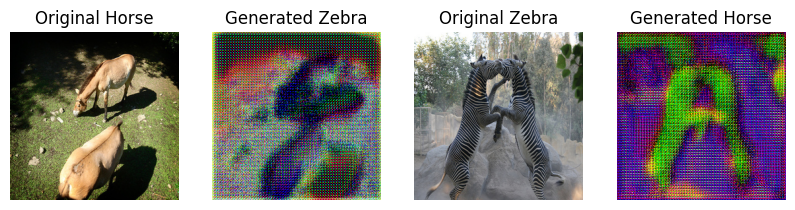

1/1 [==============================] - 0s 38ms/step


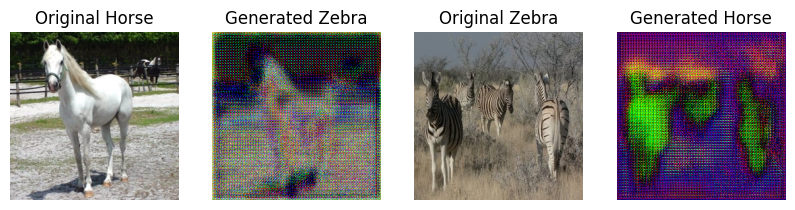

1/1 [==============================] - 0s 64ms/step


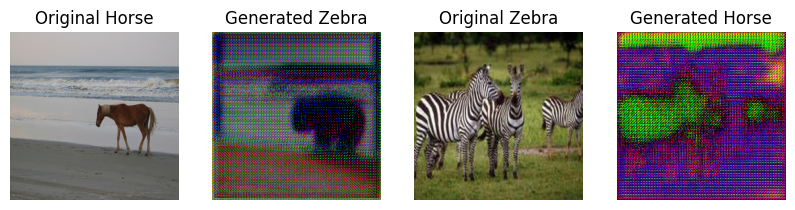

1/1 [==============================] - 0s 35ms/step


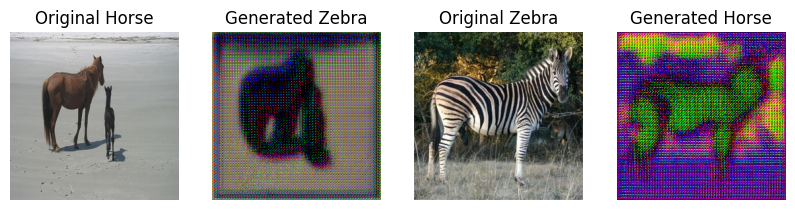

1/1 [==============================] - 0s 34ms/step


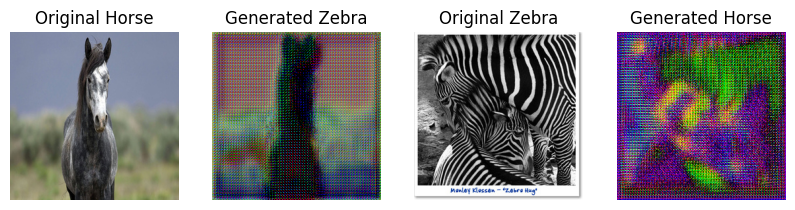

1/1 [==============================] - 0s 38ms/step


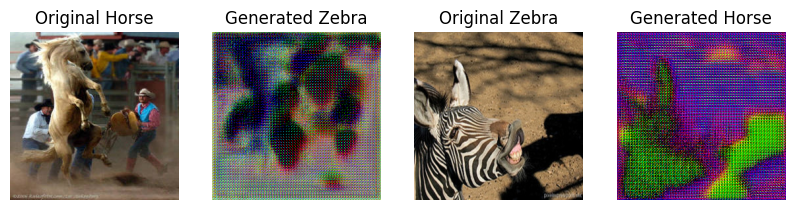

1/1 [==============================] - 0s 34ms/step


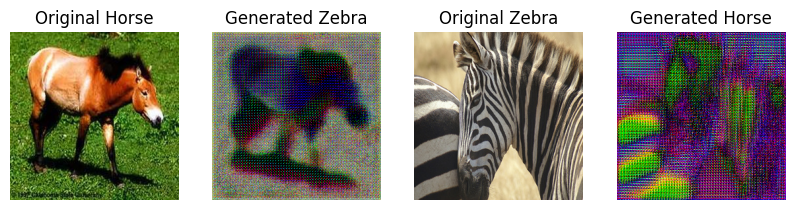

1/1 [==============================] - 0s 38ms/step


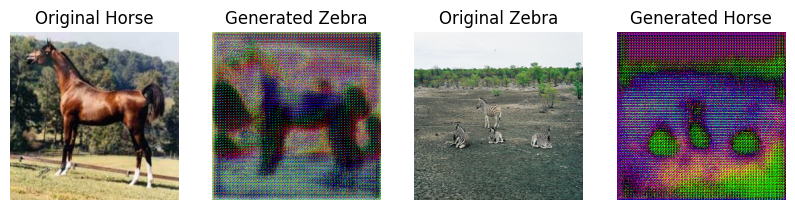

1/1 [==============================] - 0s 33ms/step


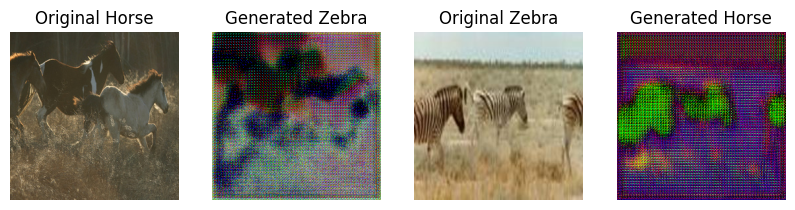

1/1 [==============================] - 0s 34ms/step


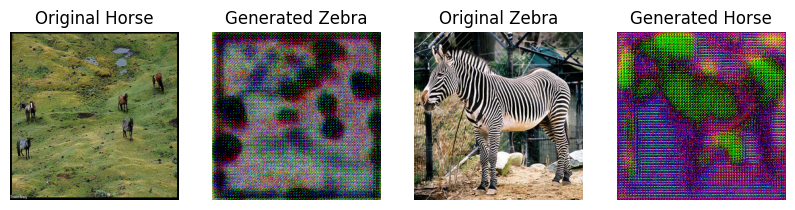

1/1 [==============================] - 0s 34ms/step


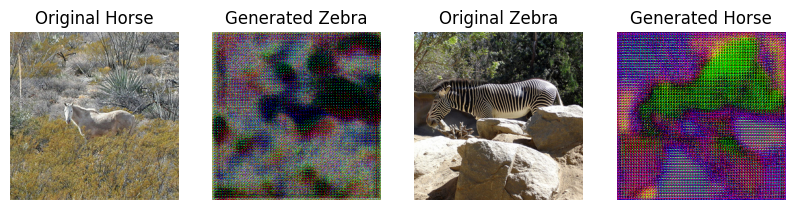

1/1 [==============================] - 0s 47ms/step


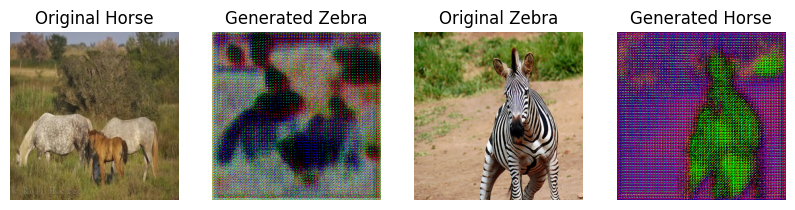

1/1 [==============================] - 0s 33ms/step


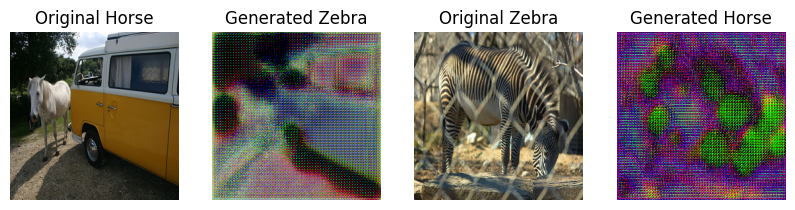

1/1 [==============================] - 0s 36ms/step


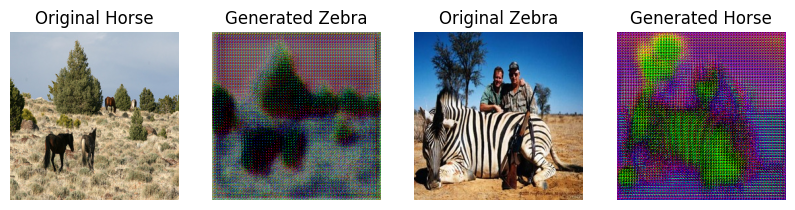

1/1 [==============================] - 0s 37ms/step


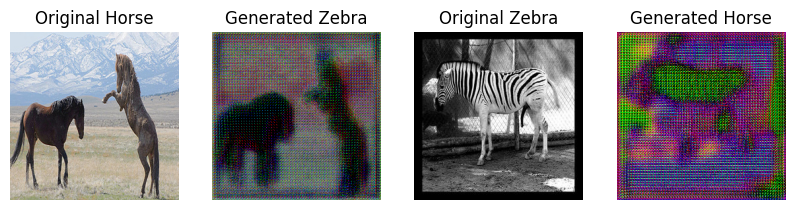

1/1 [==============================] - 0s 32ms/step


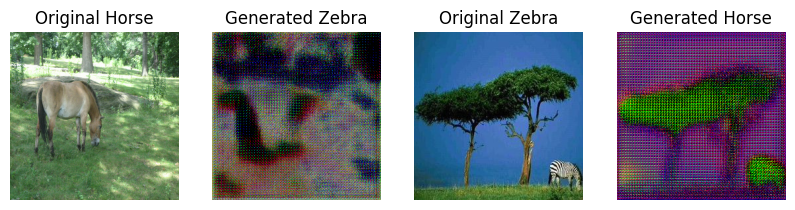

1/1 [==============================] - 0s 34ms/step


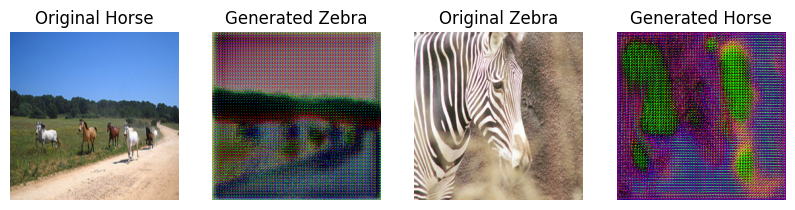

1/1 [==============================] - 0s 33ms/step


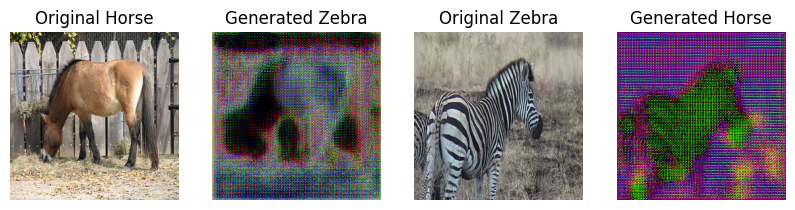

1/1 [==============================] - 0s 37ms/step


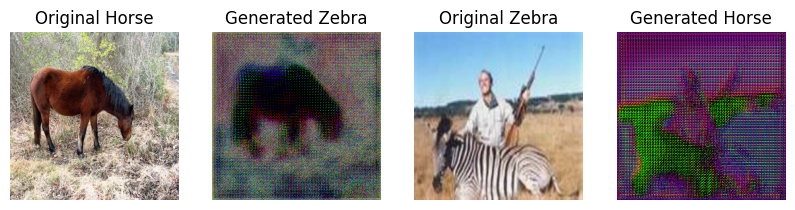

1/1 [==============================] - 0s 43ms/step


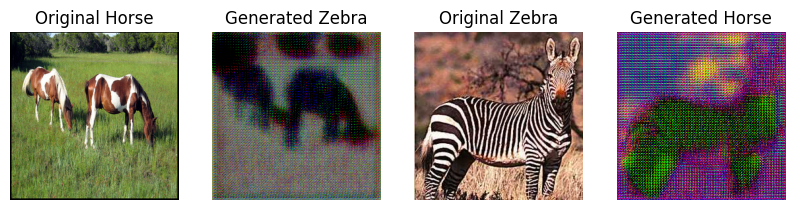

1/1 [==============================] - 0s 34ms/step


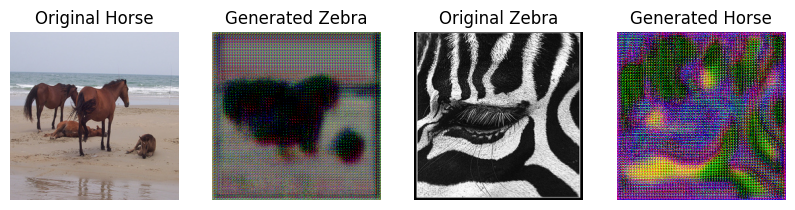

1/1 [==============================] - 0s 43ms/step


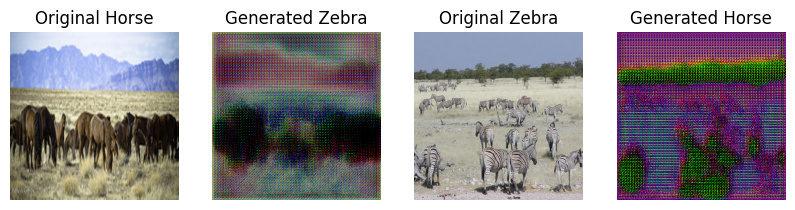

1/1 [==============================] - 0s 34ms/step


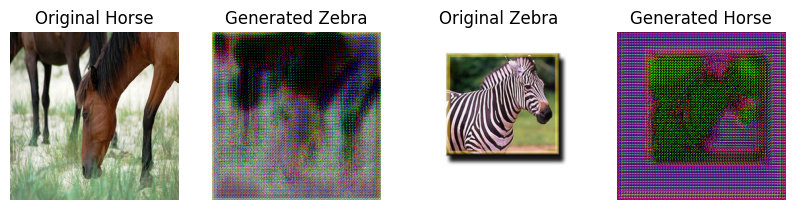

1/1 [==============================] - 0s 53ms/step


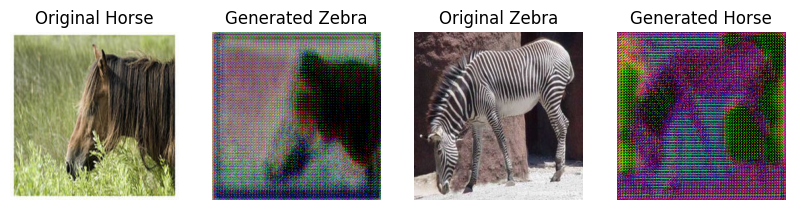

1/1 [==============================] - 0s 35ms/step


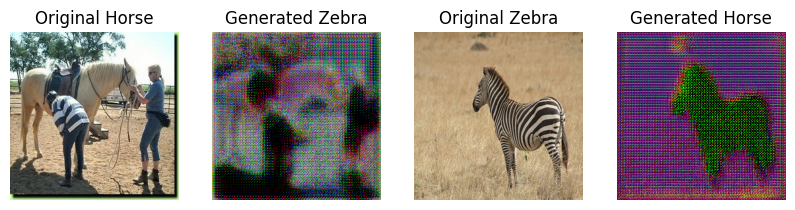

1/1 [==============================] - 0s 48ms/step


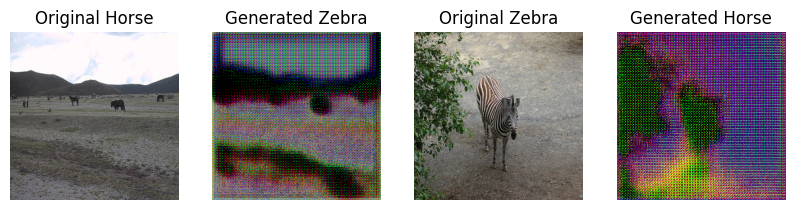

1/1 [==============================] - 0s 44ms/step


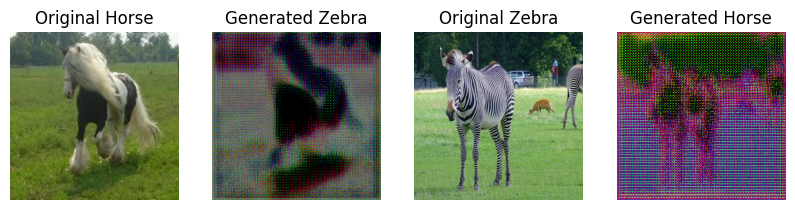

1/1 [==============================] - 0s 35ms/step


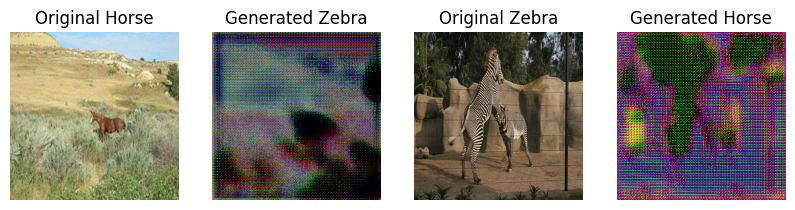

1/1 [==============================] - 0s 38ms/step


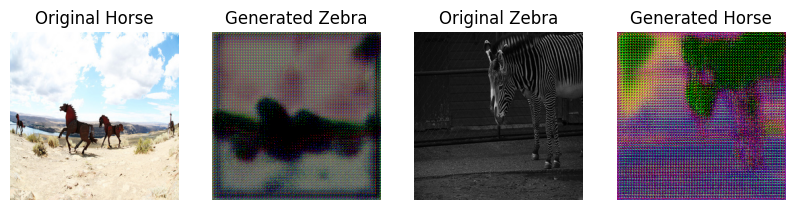

1/1 [==============================] - 0s 32ms/step


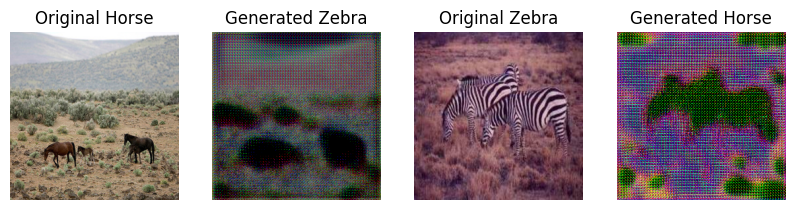

1/1 [==============================] - 0s 33ms/step


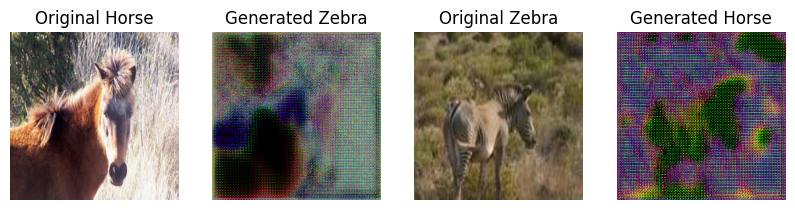

1/1 [==============================] - 0s 40ms/step


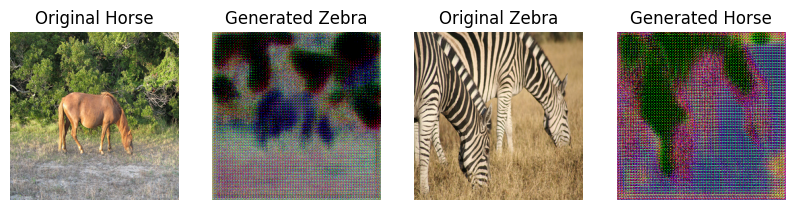

1/1 [==============================] - 0s 47ms/step


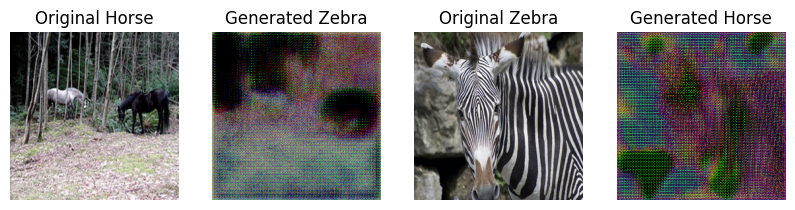

1/1 [==============================] - 0s 44ms/step


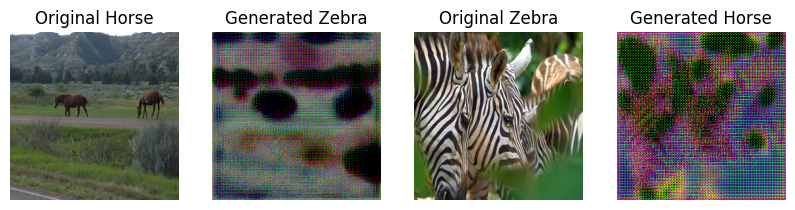

1/1 [==============================] - 0s 34ms/step


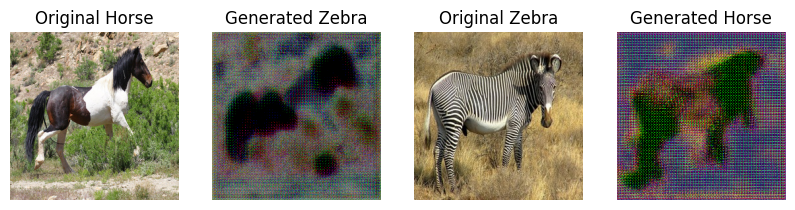

1/1 [==============================] - 0s 41ms/step


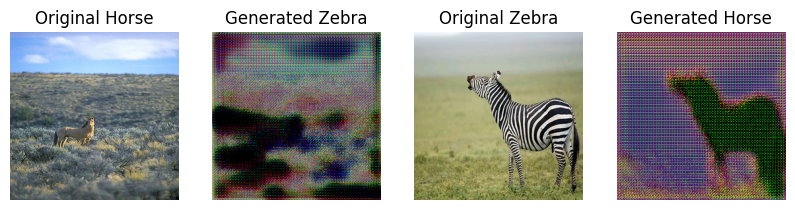

1/1 [==============================] - 0s 78ms/step


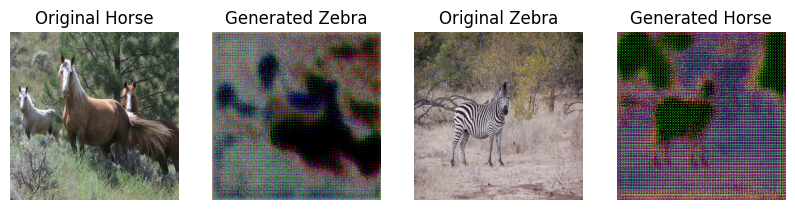

1/1 [==============================] - 0s 37ms/step


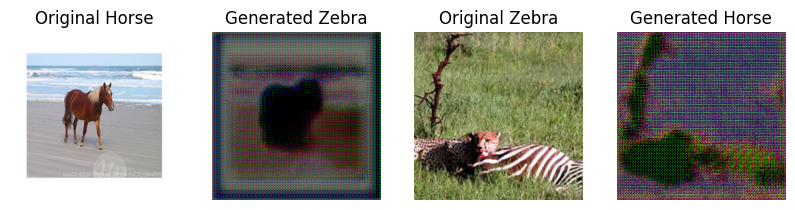

1/1 [==============================] - 0s 83ms/step


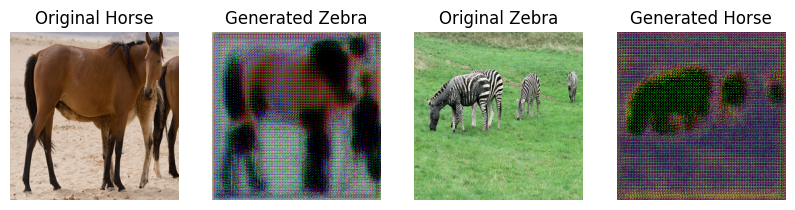

1/1 [==============================] - 0s 34ms/step


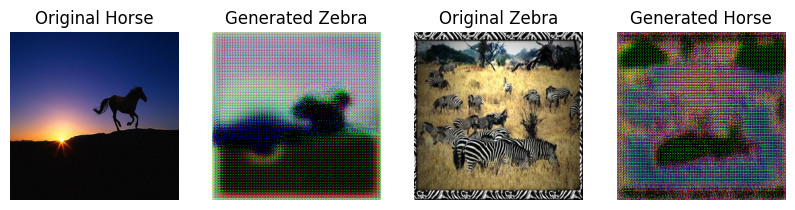

1/1 [==============================] - 0s 34ms/step


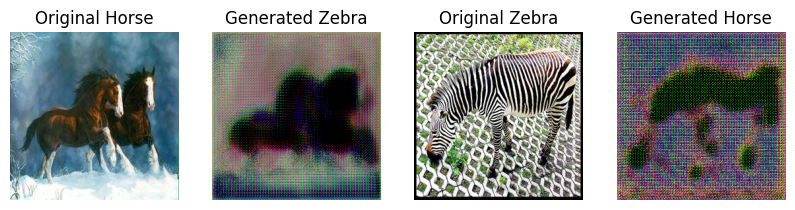

1/1 [==============================] - 0s 36ms/step


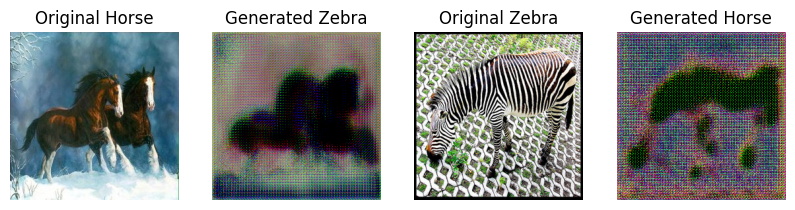

1/1 [==============================] - 0s 34ms/step


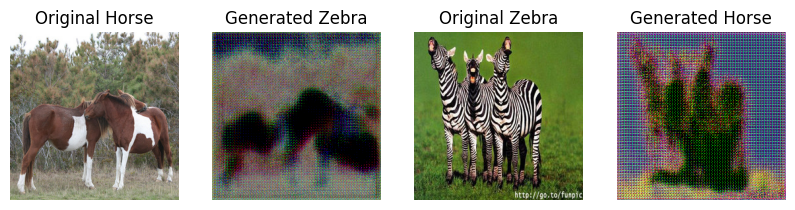

1/1 [==============================] - 0s 72ms/step


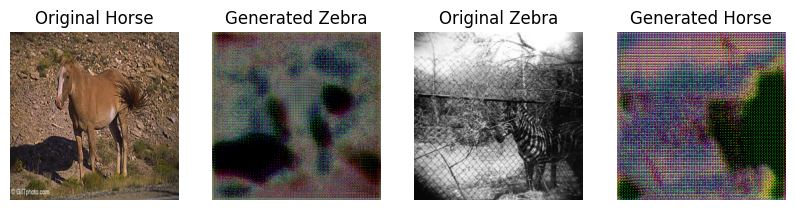

1/1 [==============================] - 0s 35ms/step


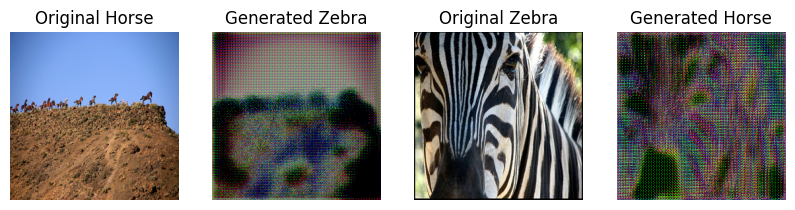

1/1 [==============================] - 0s 31ms/step


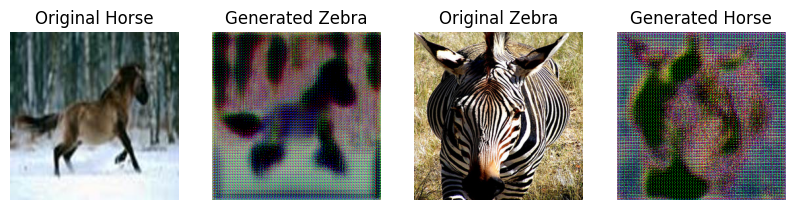

1/1 [==============================] - 0s 83ms/step


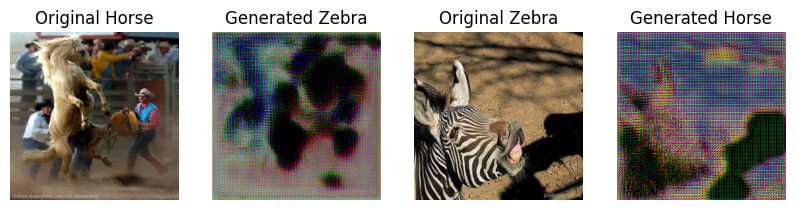

1/1 [==============================] - 0s 40ms/step


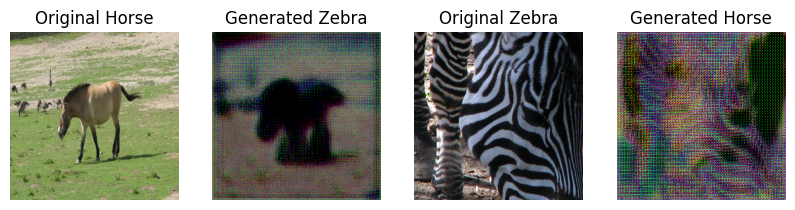

1/1 [==============================] - 0s 56ms/step


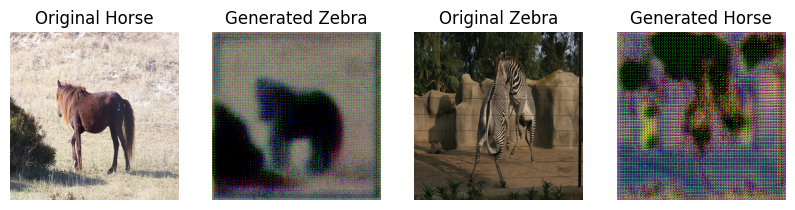

1/1 [==============================] - 0s 33ms/step


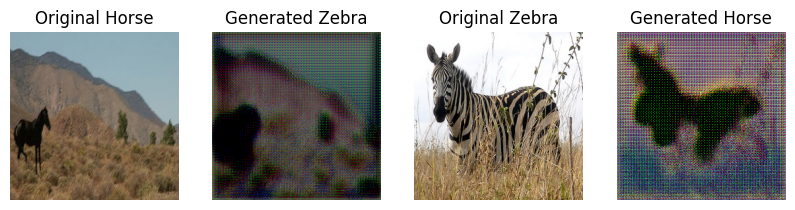

1/1 [==============================] - 0s 33ms/step


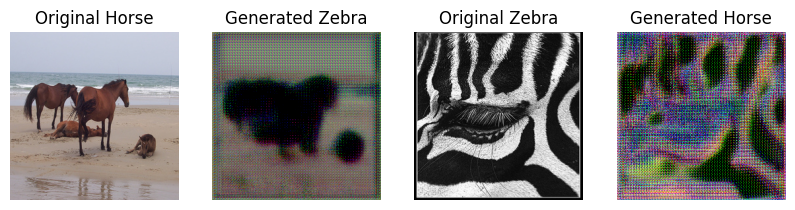

1/1 [==============================] - 0s 47ms/step


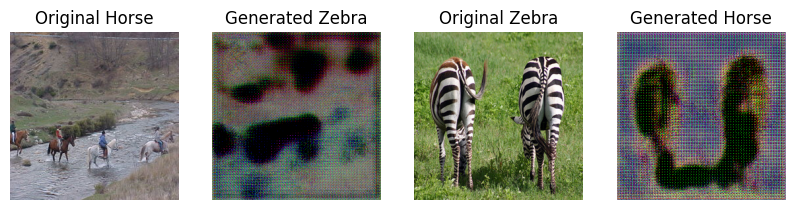

1/1 [==============================] - 0s 34ms/step


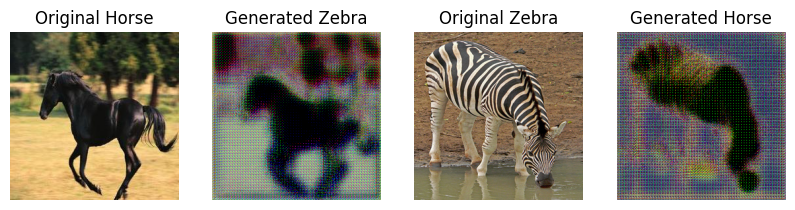

1/1 [==============================] - 0s 38ms/step


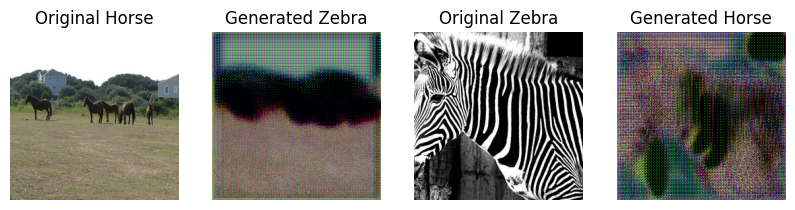

1/1 [==============================] - 0s 33ms/step


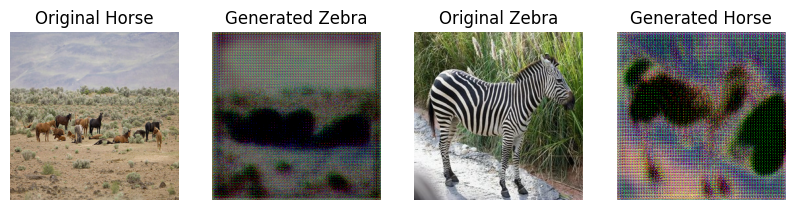

1/1 [==============================] - 0s 36ms/step


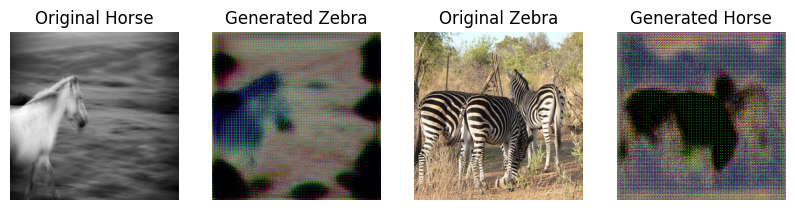

1/1 [==============================] - 0s 48ms/step


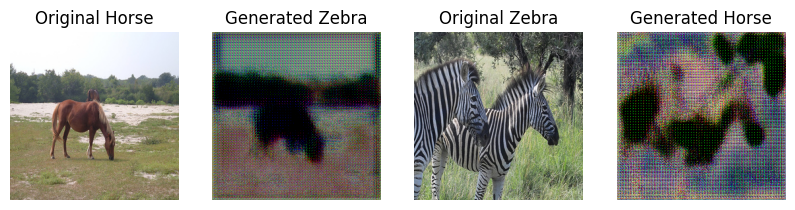

1/1 [==============================] - 0s 32ms/step


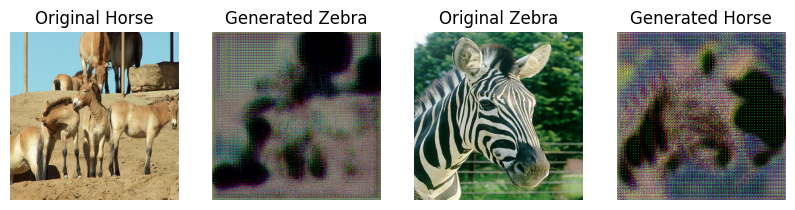

1/1 [==============================] - 0s 32ms/step


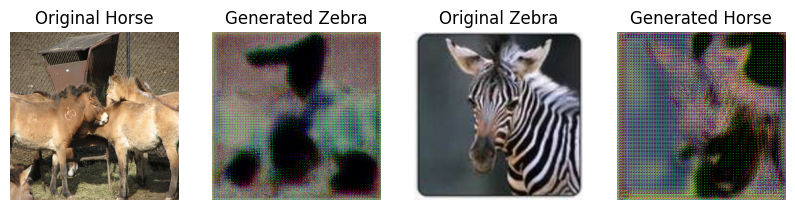

1/1 [==============================] - 0s 31ms/step


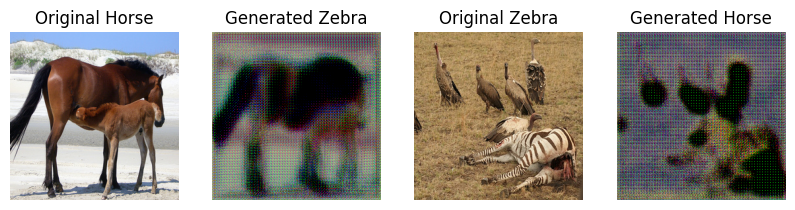

1/1 [==============================] - 0s 35ms/step


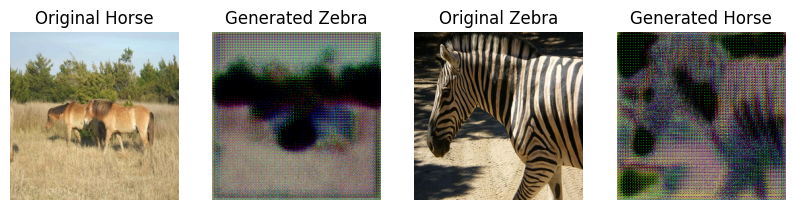

1/1 [==============================] - 0s 74ms/step


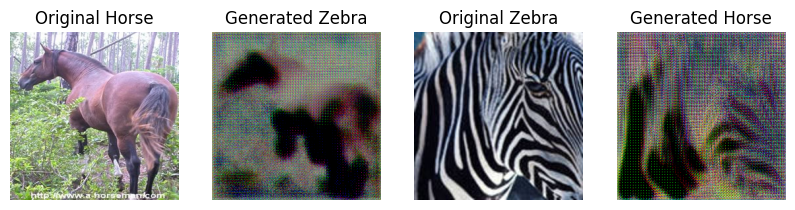

1/1 [==============================] - 0s 32ms/step


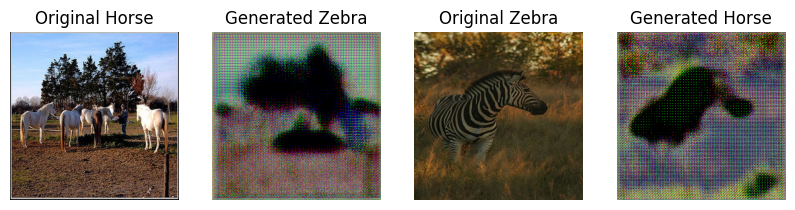

1/1 [==============================] - 0s 32ms/step


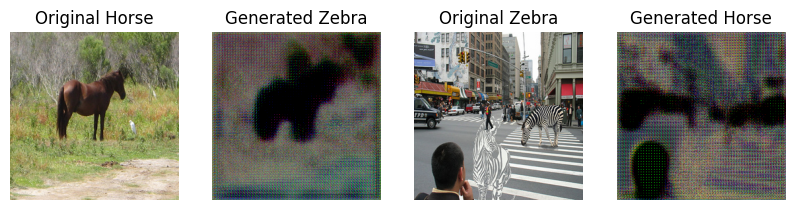

1/1 [==============================] - 0s 33ms/step


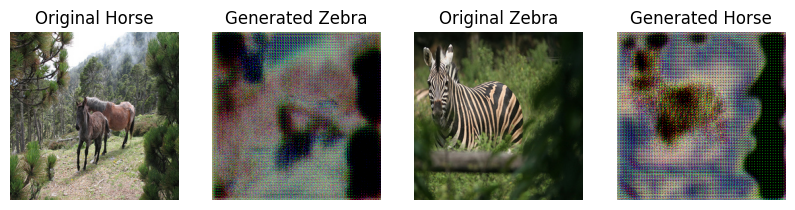

1/1 [==============================] - 0s 35ms/step


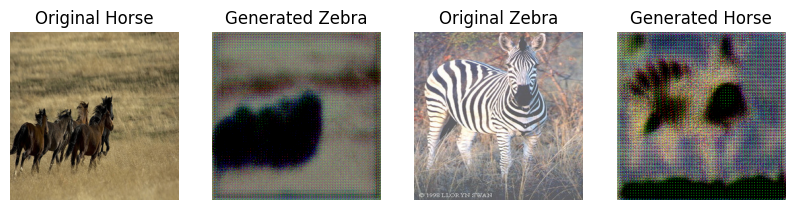

1/1 [==============================] - 0s 32ms/step


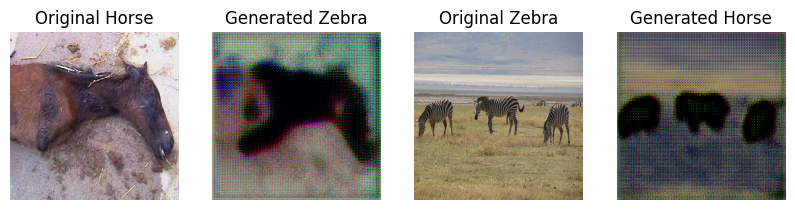

1/1 [==============================] - 0s 33ms/step


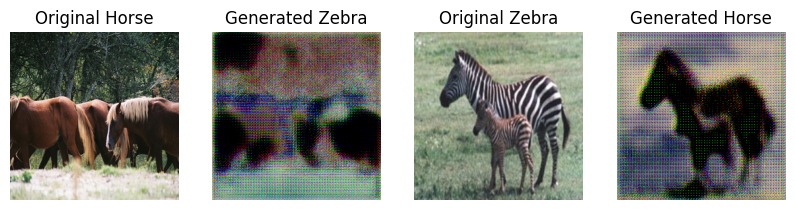

1/1 [==============================] - 0s 69ms/step


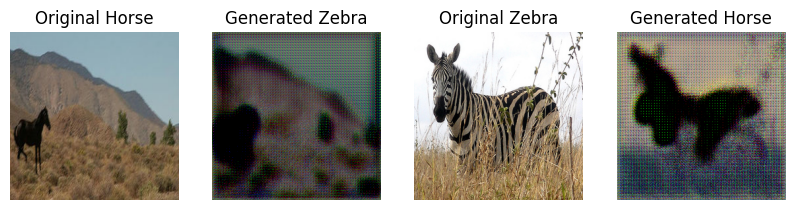

1/1 [==============================] - 0s 36ms/step


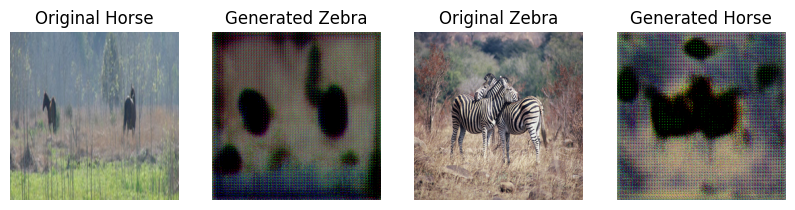

1/1 [==============================] - 0s 49ms/step


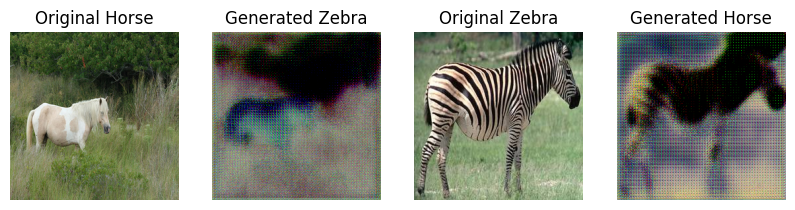

1/1 [==============================] - 0s 33ms/step


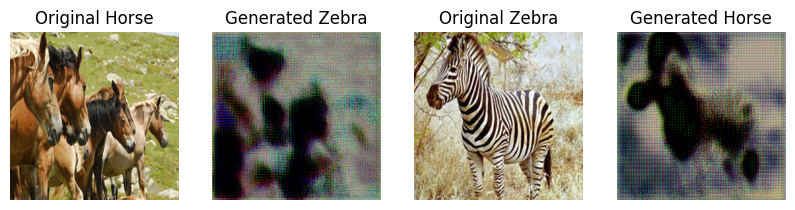

1/1 [==============================] - 0s 33ms/step


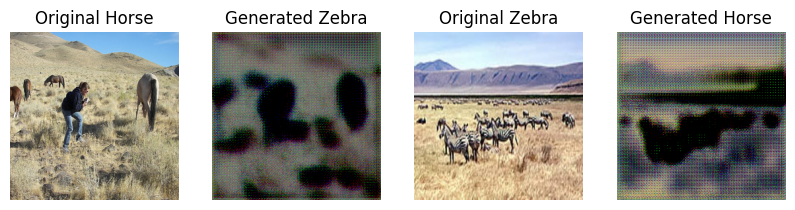

1/1 [==============================] - 0s 32ms/step


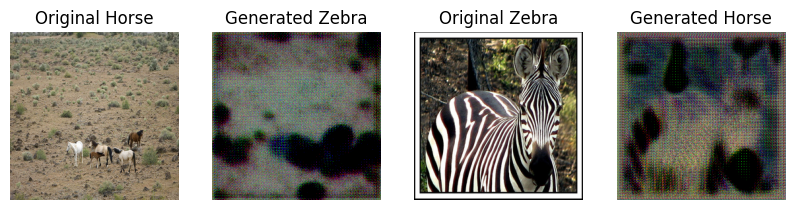

1/1 [==============================] - 0s 33ms/step


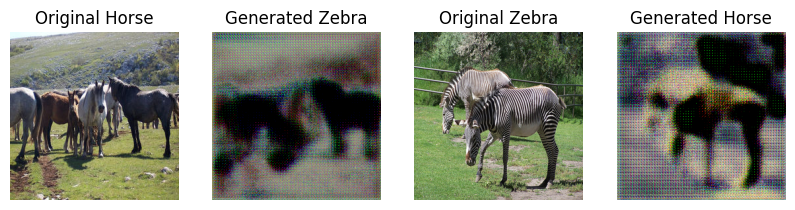

1/1 [==============================] - 0s 33ms/step


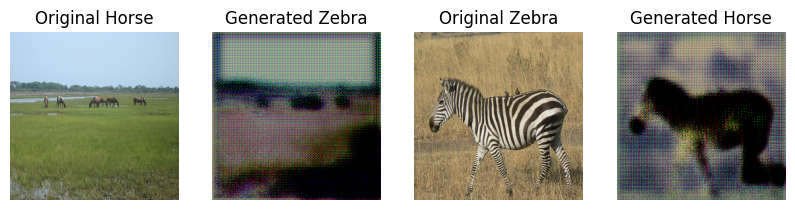

1/1 [==============================] - 0s 32ms/step


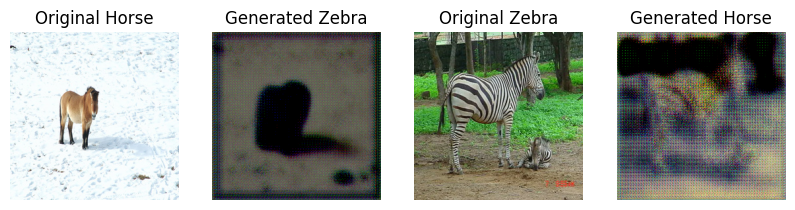

1/1 [==============================] - 0s 69ms/step


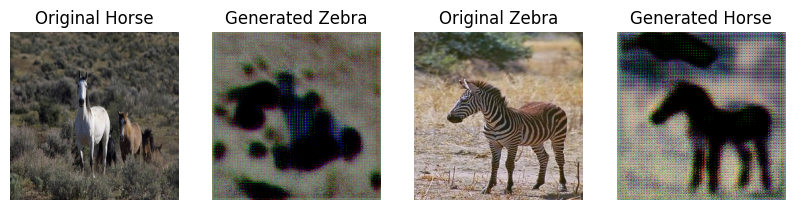

1/1 [==============================] - 0s 31ms/step


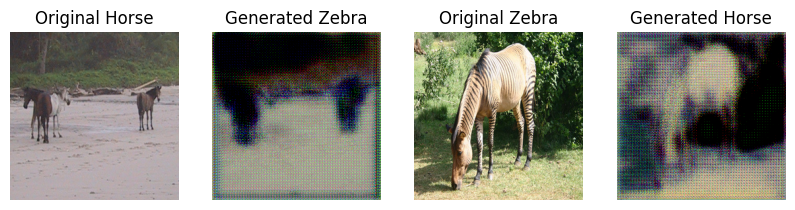

1/1 [==============================] - 0s 33ms/step


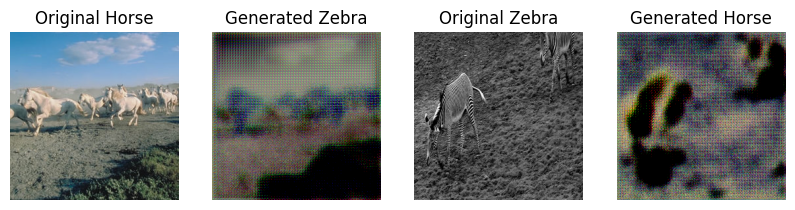

1/1 [==============================] - 0s 36ms/step


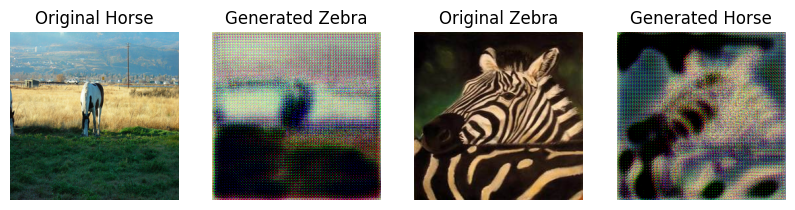

1/1 [==============================] - 0s 34ms/step


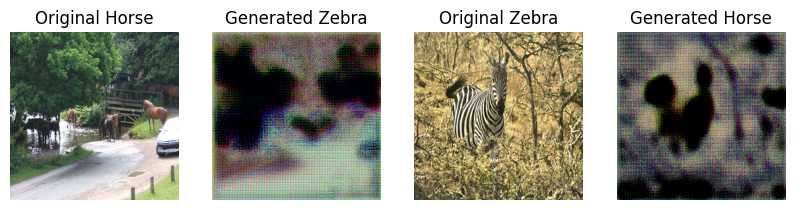

1/1 [==============================] - 0s 32ms/step


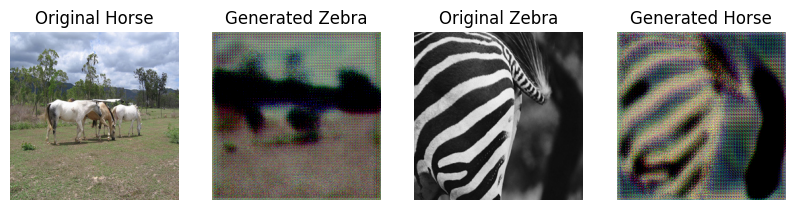

1/1 [==============================] - 0s 32ms/step


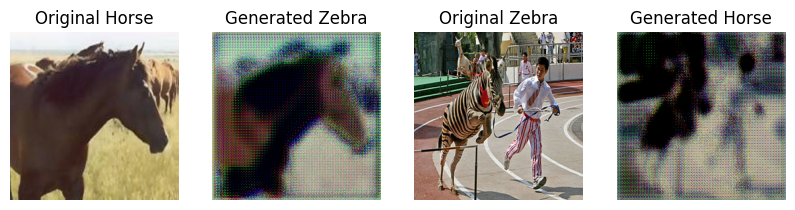

1/1 [==============================] - 0s 41ms/step


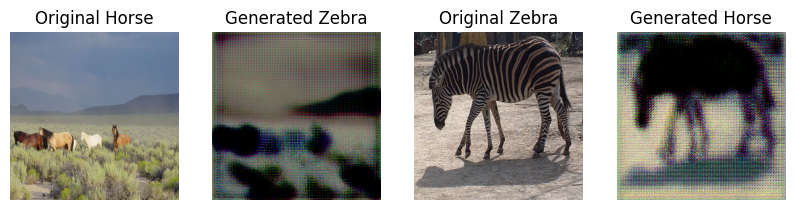

1/1 [==============================] - 0s 74ms/step


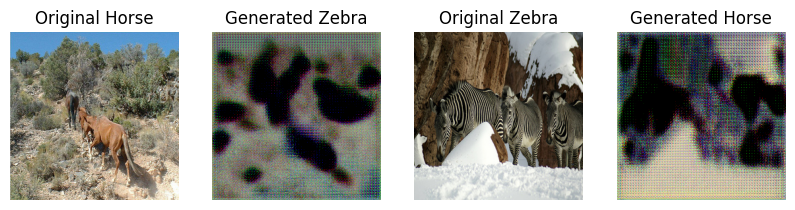

1/1 [==============================] - 0s 33ms/step


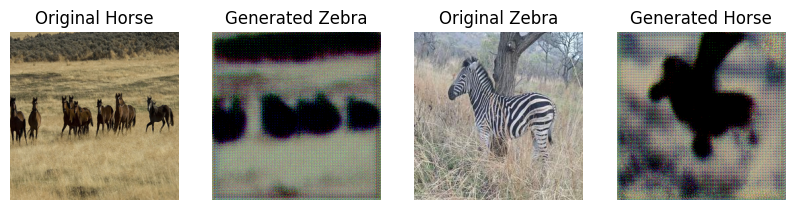

1/1 [==============================] - 0s 36ms/step


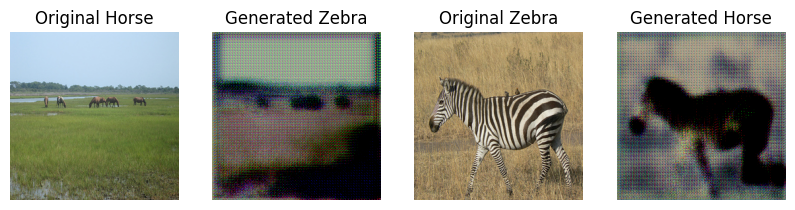

1/1 [==============================] - 0s 34ms/step


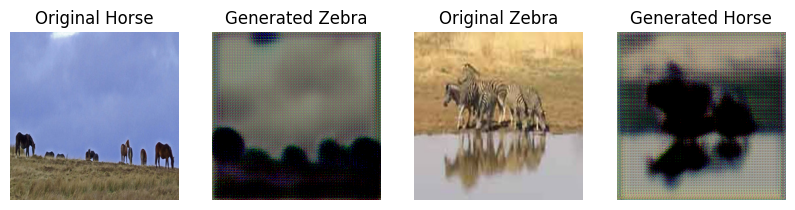

1/1 [==============================] - 0s 39ms/step


Buffered data was truncated after reaching the output size limit.

In [ ]:
import warnings
warnings.simplefilter('ignore')
train(d_A, d_B, g_AB, g_BA, c_AB, c_BA, epochs=1)
# training the model and displaying results